## Random Forest

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

In [ ]:
df= pd.read_csv("final_prepared_data.csv")

In [ ]:
df

,level_0,index,Date,Volume,Open,High,Low,Close,Adj close,Sentiment_gpt,...,Open_tomorrow,High_tomorrow,Low_tomorrow,Close_tomorrow,Adj close_tomorrow,Symbol,high_to_low,close_to_open,daily_range_pct,volume_per_price
0,72922,72922,2009-04-14 00:00:00+00:00,7167400.0,87.779999,87.809998,87.040001,87.370003,87.370003,3.00,...,87.419998,87.940002,87.230003,87.500000,87.500000,GLD,1.008846,0.995329,0.008772,82035.020885
1,72923,72923,2009-04-15 00:00:00+00:00,6857000.0,87.419998,87.940002,87.230003,87.500000,87.500000,3.00,...,87.379997,87.449997,85.680000,85.809998,85.809998,GLD,1.008139,1.000915,0.008122,78365.714286
2,72924,72924,2009-04-16 00:00:00+00:00,21033600.0,87.379997,87.449997,85.680000,85.809998,85.809998,3.00,...,85.750000,86.370003,84.919998,85.220001,85.220001,GLD,1.020658,0.982033,0.020256,245118.291556
3,72925,72925,2009-04-17 00:00:00+00:00,22332700.0,85.750000,86.370003,84.919998,85.220001,85.220001,3.00,...,86.029999,87.339996,86.000000,86.949997,86.949997,GLD,1.017075,0.993819,0.016910,262059.371980
4,72926,72926,2009-04-20 00:00:00+00:00,12674400.0,86.029999,87.339996,86.000000,86.949997,86.949997,3.00,...,87.849998,87.879997,86.330002,86.889999,86.889999,GLD,1.015581,1.010694,0.015576,145766.537606
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127882,102441,102441,2023-12-20 00:00:00+00:00,54671700.0,139.000000,139.580002,135.369995,135.470001,135.470001,4.40,...,138.139999,139.979996,137.380005,139.910004,139.910004,AMD,1.031100,0.974604,0.030288,403570.528585
127883,102442,102442,2023-12-21 00:00:00+00:00,47179400.0,138.139999,139.979996,137.380005,139.910004,139.910004,4.00,...,140.479996,140.699997,138.309998,139.600006,139.600006,AMD,1.018926,1.012813,0.018821,337212.484920
127884,102443,102443,2023-12-22 00:00:00+00:00,35370400.0,140.479996,140.699997,138.309998,139.600006,139.600006,4.00,...,140.070007,143.850006,139.919998,143.410004,143.410004,AMD,1.017280,0.993736,0.017013,253369.616429
127885,102444,102444,2023-12-26 00:00:00+00:00,47157400.0,140.070007,143.850006,139.919998,143.410004,143.410004,3.75,...,144.720001,146.250000,143.179993,146.070007,146.070007,AMD,1.028088,1.023845,0.028057,328829.222480


In [ ]:
df.drop(columns=["level_0", "index"], inplace= True)

In [ ]:
df

,Date,Volume,Open,High,Low,Close,Adj close,Sentiment_gpt,News_flag,Scaled_sentiment,...,Open_tomorrow,High_tomorrow,Low_tomorrow,Close_tomorrow,Adj close_tomorrow,Symbol,high_to_low,close_to_open,daily_range_pct,volume_per_price
0,2009-04-14 00:00:00+00:00,7167400.0,87.779999,87.809998,87.040001,87.370003,87.370003,3.00,1,0.500025,...,87.419998,87.940002,87.230003,87.500000,87.500000,GLD,1.008846,0.995329,0.008772,82035.020885
1,2009-04-15 00:00:00+00:00,6857000.0,87.419998,87.940002,87.230003,87.500000,87.500000,3.00,0,0.500025,...,87.379997,87.449997,85.680000,85.809998,85.809998,GLD,1.008139,1.000915,0.008122,78365.714286
2,2009-04-16 00:00:00+00:00,21033600.0,87.379997,87.449997,85.680000,85.809998,85.809998,3.00,0,0.500025,...,85.750000,86.370003,84.919998,85.220001,85.220001,GLD,1.020658,0.982033,0.020256,245118.291556
3,2009-04-17 00:00:00+00:00,22332700.0,85.750000,86.370003,84.919998,85.220001,85.220001,3.00,0,0.500025,...,86.029999,87.339996,86.000000,86.949997,86.949997,GLD,1.017075,0.993819,0.016910,262059.371980
4,2009-04-20 00:00:00+00:00,12674400.0,86.029999,87.339996,86.000000,86.949997,86.949997,3.00,0,0.500025,...,87.849998,87.879997,86.330002,86.889999,86.889999,GLD,1.015581,1.010694,0.015576,145766.537606
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127882,2023-12-20 00:00:00+00:00,54671700.0,139.000000,139.580002,135.369995,135.470001,135.470001,4.40,1,0.850025,...,138.139999,139.979996,137.380005,139.910004,139.910004,AMD,1.031100,0.974604,0.030288,403570.528585
127883,2023-12-21 00:00:00+00:00,47179400.0,138.139999,139.979996,137.380005,139.910004,139.910004,4.00,1,0.750025,...,140.479996,140.699997,138.309998,139.600006,139.600006,AMD,1.018926,1.012813,0.018821,337212.484920
127884,2023-12-22 00:00:00+00:00,35370400.0,140.479996,140.699997,138.309998,139.600006,139.600006,4.00,1,0.750025,...,140.070007,143.850006,139.919998,143.410004,143.410004,AMD,1.017280,0.993736,0.017013,253369.616429
127885,2023-12-26 00:00:00+00:00,47157400.0,140.070007,143.850006,139.919998,143.410004,143.410004,3.75,1,0.687525,...,144.720001,146.250000,143.179993,146.070007,146.070007,AMD,1.028088,1.023845,0.028057,328829.222480


In [ ]:
# Make a copy so you preserve the original if needed
df_model = df.copy()

# Log-transform Volume_tomorrow (add 1 to avoid log(0))
df_model['log_Volume_tomorrow'] = np.log1p(df_model['Volume_tomorrow'])

In [ ]:
#the target columns
target_cols = ['Volume_tomorrow', 'Open_tomorrow', 'High_tomorrow', 'Low_tomorrow', 'Close_tomorrow', 'Adj close_tomorrow']

#the input features
X = df.drop(columns=target_cols)

le = LabelEncoder()
# Encode 'Symbol' if it's still present
if 'Symbol' in X.columns:
    X['Symbol'] = le.fit_transform(X['Symbol'])

# Define targets
y = df[target_cols]


In [ ]:
X.drop(columns=['Date'], inplace= True)

In [ ]:
X['Volume'] = np.log1p(X['Volume'])

In [ ]:
X

,Volume,Open,High,Low,Close,Adj close,Sentiment_gpt,News_flag,Scaled_sentiment,Symbol,high_to_low,close_to_open,daily_range_pct,volume_per_price
0,15.785054,87.779999,87.809998,87.040001,87.370003,87.370003,3.00,1,0.500025,24,1.008846,0.995329,0.008772,82035.020885
1,15.740781,87.419998,87.940002,87.230003,87.500000,87.500000,3.00,0,0.500025,24,1.008139,1.000915,0.008122,78365.714286
2,16.861632,87.379997,87.449997,85.680000,85.809998,85.809998,3.00,0,0.500025,24,1.020658,0.982033,0.020256,245118.291556
3,16.921563,85.750000,86.370003,84.919998,85.220001,85.220001,3.00,0,0.500025,24,1.017075,0.993819,0.016910,262059.371980
4,16.355095,86.029999,87.339996,86.000000,86.949997,86.949997,3.00,0,0.500025,24,1.015581,1.010694,0.015576,145766.537606
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127882,17.816857,139.000000,139.580002,135.369995,135.470001,135.470001,4.40,1,0.850025,3,1.031100,0.974604,0.030288,403570.528585
127883,17.669468,138.139999,139.979996,137.380005,139.910004,139.910004,4.00,1,0.750025,3,1.018926,1.012813,0.018821,337212.484920
127884,17.381386,140.479996,140.699997,138.309998,139.600006,139.600006,4.00,1,0.750025,3,1.017280,0.993736,0.017013,253369.616429
127885,17.669002,140.070007,143.850006,139.919998,143.410004,143.410004,3.75,1,0.687525,3,1.028088,1.023845,0.028057,328829.222480


In [ ]:
X['volume_per_price'] = np.log1p(X['volume_per_price'])

In [ ]:
X

,Volume,Open,High,Low,Close,Adj close,Sentiment_gpt,News_flag,Scaled_sentiment,Symbol,high_to_low,close_to_open,daily_range_pct,volume_per_price
0,15.785054,87.779999,87.809998,87.040001,87.370003,87.370003,3.00,1,0.500025,24,1.008846,0.995329,0.008772,11.314914
1,15.740781,87.419998,87.940002,87.230003,87.500000,87.500000,3.00,0,0.500025,24,1.008139,1.000915,0.008122,11.269155
2,16.861632,87.379997,87.449997,85.680000,85.809998,85.809998,3.00,0,0.500025,24,1.020658,0.982033,0.020256,12.409500
3,16.921563,85.750000,86.370003,84.919998,85.220001,85.220001,3.00,0,0.500025,24,1.017075,0.993819,0.016910,12.476330
4,16.355095,86.029999,87.339996,86.000000,86.949997,86.949997,3.00,0,0.500025,24,1.015581,1.010694,0.015576,11.889768
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127882,17.816857,139.000000,139.580002,135.369995,135.470001,135.470001,4.40,1,0.850025,3,1.031100,0.974604,0.030288,12.908109
127883,17.669468,138.139999,139.979996,137.380005,139.910004,139.910004,4.00,1,0.750025,3,1.018926,1.012813,0.018821,12.728471
127884,17.381386,140.479996,140.699997,138.309998,139.600006,139.600006,4.00,1,0.750025,3,1.017280,0.993736,0.017013,12.442609
127885,17.669002,140.070007,143.850006,139.919998,143.410004,143.410004,3.75,1,0.687525,3,1.028088,1.023845,0.028057,12.703297


In [ ]:
y['Volume_tomorrow'] = np.log1p(y['Volume_tomorrow'])

<ipython-input-13-bd01078d52b6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y['Volume_tomorrow'] = np.log1p(y['Volume_tomorrow'])


In [ ]:
y

,Volume_tomorrow,Open_tomorrow,High_tomorrow,Low_tomorrow,Close_tomorrow,Adj close_tomorrow
0,15.740781,87.419998,87.940002,87.230003,87.500000,87.500000
1,16.861632,87.379997,87.449997,85.680000,85.809998,85.809998
2,16.921563,85.750000,86.370003,84.919998,85.220001,85.220001
3,16.355095,86.029999,87.339996,86.000000,86.949997,86.949997
4,16.181624,87.849998,87.879997,86.330002,86.889999,86.889999
...,...,...,...,...,...,...
127882,17.669468,138.139999,139.979996,137.380005,139.910004,139.910004
127883,17.381386,140.479996,140.699997,138.309998,139.600006,139.600006
127884,17.669002,140.070007,143.850006,139.919998,143.410004,143.410004
127885,17.708012,144.720001,146.250000,143.179993,146.070007,146.070007


In [ ]:
scaler_X = StandardScaler()
scaler_y = StandardScaler()

X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y)


In [ ]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor()
rf.fit(X_train, y_train[target_cols])
y_pred = rf.predict(X_test)


In [ ]:
import numpy as np
from sklearn.metrics import mean_squared_error, r2_score

for i, col in enumerate(target_cols):
    y_true = y_test.iloc[:, i]
    y_pred_col = y_pred[:, i]

    mse = mean_squared_error(y_true, y_pred_col)      # standard MSE
    rmse = np.sqrt(mse)                               # square root
    r2   = r2_score(y_true, y_pred_col)

    print(f"{col} → RMSE: {rmse:.2f}, R²: {r2:.2f}")



Volume_tomorrow → RMSE: 0.45, R²: 0.88
Open_tomorrow → RMSE: 9.05, R²: 1.00
High_tomorrow → RMSE: 9.47, R²: 1.00
Low_tomorrow → RMSE: 9.25, R²: 1.00
Close_tomorrow → RMSE: 9.70, R²: 1.00
Adj close_tomorrow → RMSE: 9.69, R²: 1.00


# **XAI-Techniques**

In [ ]:
!pip install lime
!pip install SHAP
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance
from lime.lime_tabular import LimeTabularExplainer
import shap
import lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=d9fcd08d6bfb2ead2d5f56755f72a456ba2f94840c47be80845fcf745d9d2073
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


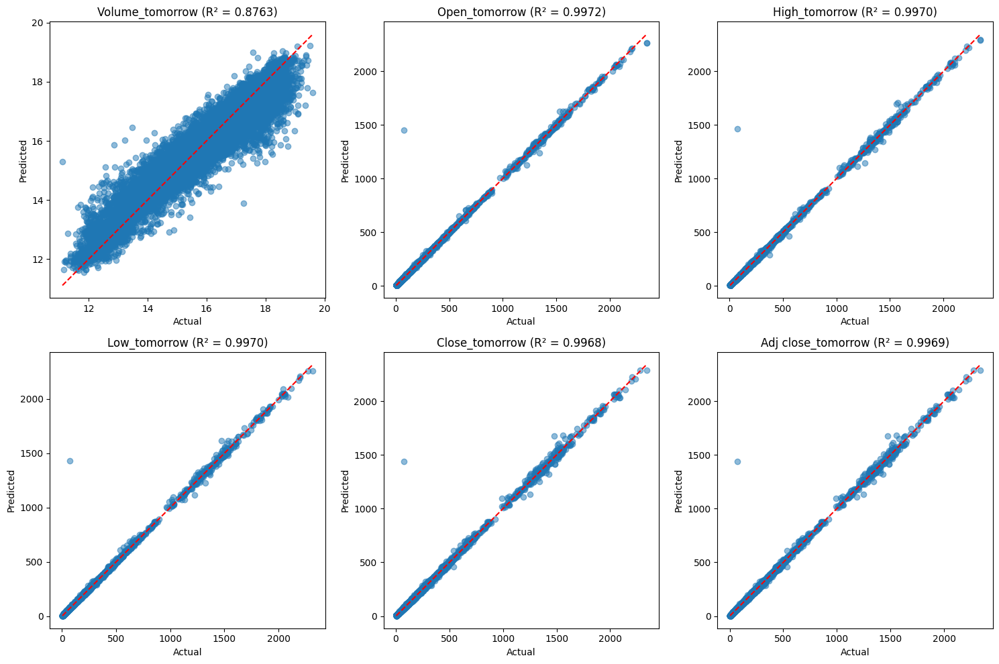

In [ ]:
plt.figure(figsize=(15, 10))
for i, col in enumerate(y_test.columns):
    plt.subplot(2, 3, i+1)
    plt.scatter(y_test.iloc[:, i], y_pred[:, i], alpha=0.5)
    plt.plot([y_test.iloc[:, i].min(), y_test.iloc[:, i].max()],
             [y_test.iloc[:, i].min(), y_test.iloc[:, i].max()], 'r--')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{col} (R² = {r2_score(y_test.iloc[:, i], y_pred[:, i]):.4f})')
plt.tight_layout()
plt.savefig('prediction_results.png')
plt.show()

# **FEATURE IMPORTANCE**

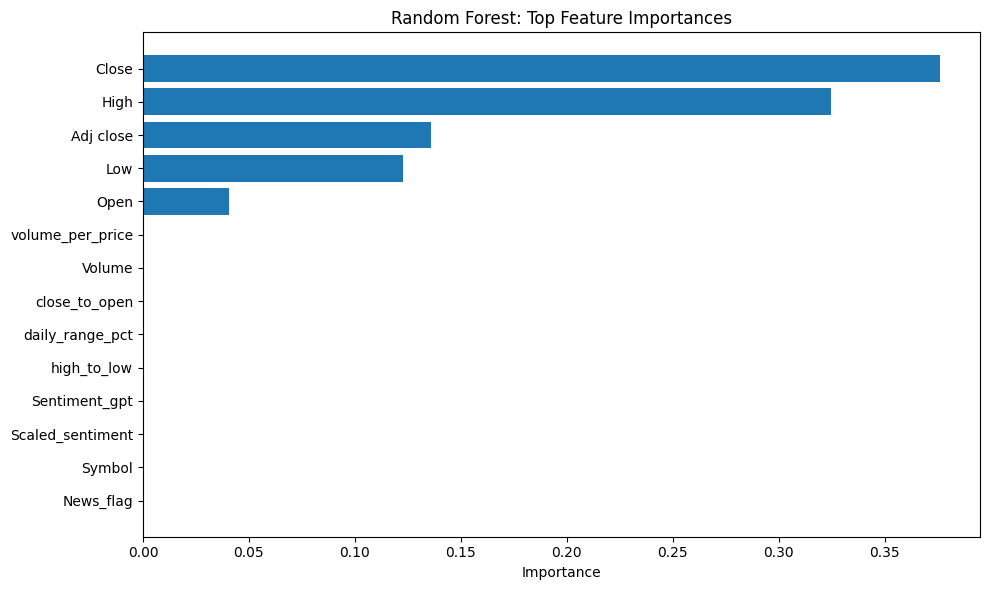

In [ ]:
# 1) BUILT-IN FEATURE IMPORTANCE
feat_imps = rf.feature_importances_
feat_names = X_train.columns
order = np.argsort(feat_imps)[::-1]

plt.figure(figsize=(10,6))
plt.barh(feat_names[order][:20][::-1], feat_imps[order][:20][::-1])
plt.xlabel("Importance")
plt.title("Random Forest: Top Feature Importances")
plt.tight_layout()
plt.show()

# **Permutation Importance**

<ipython-input-22-4bdc19274099>:33: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


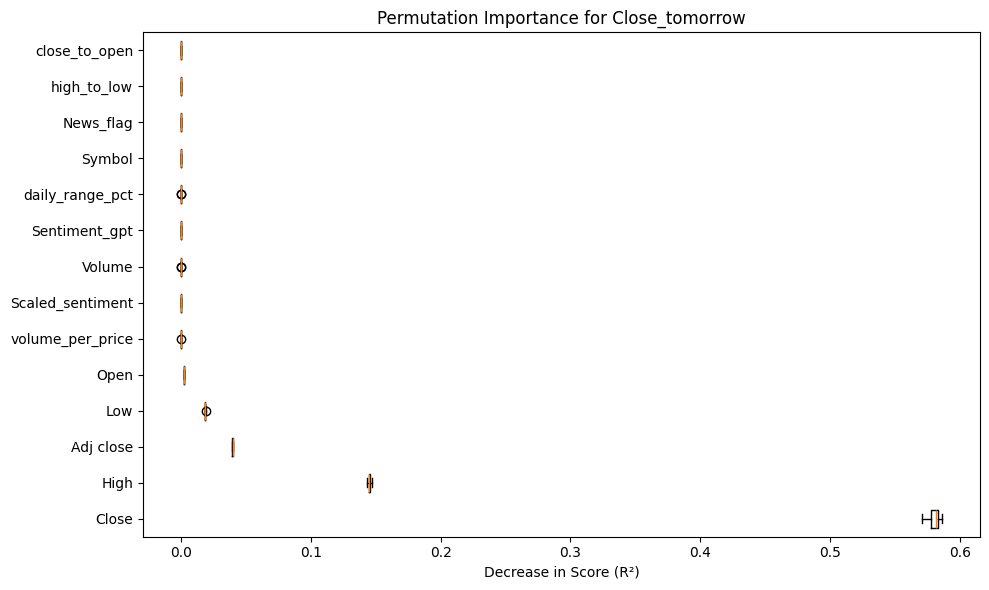

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance
from sklearn.base import BaseEstimator, RegressorMixin

class SingleTargetRegressor(BaseEstimator, RegressorMixin):
    def __init__(self, multioutput_model, target_idx):
        self.model = multioutput_model
        self.target_idx = target_idx

    def fit(self, X, y=None):
        return self

    def predict(self, X):
        return self.model.predict(X)[:, self.target_idx]

# target 'Close_tomorrow'
target_name = 'Close_tomorrow'
target_idx  = target_cols.index(target_name)

wrapper = SingleTargetRegressor(rf, target_idx)

perm = permutation_importance(
    wrapper,
    X_test,
    y_test[target_name],
    n_repeats=10,
    random_state=42
)

idxs = np.argsort(perm.importances_mean)[::-1][:15]
plt.figure(figsize=(10, 6))
plt.boxplot(
    perm.importances[idxs].T,
    vert=False,
    labels=X_test.columns[idxs]
)
plt.title(f"Permutation Importance for {target_name}")
plt.xlabel("Decrease in Score (R²)")
plt.tight_layout()
plt.show()

<ipython-input-23-bb3e88450596>:9: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(result.importances[sorted_idx].T,


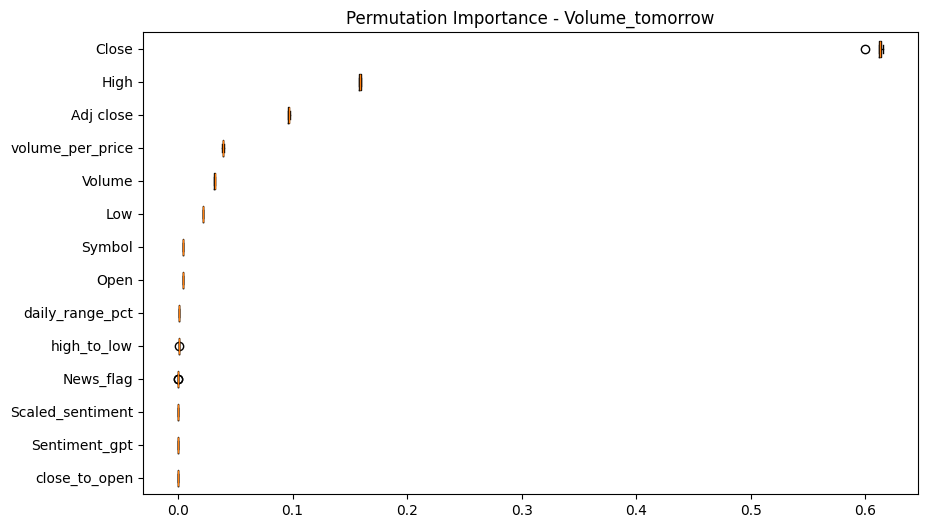

In [ ]:
from sklearn.inspection import permutation_importance

# Calculate permutation importance
result = permutation_importance(rf, X_test, y_test, n_repeats=5, random_state=42)

# Plot for first target (Volume_tomorrow)
sorted_idx = result.importances_mean.argsort()
plt.figure(figsize=(10,6))
plt.boxplot(result.importances[sorted_idx].T,
            vert=False, labels=X_test.columns[sorted_idx])
plt.title("Permutation Importance - Volume_tomorrow")
plt.show()

# **SHAP**

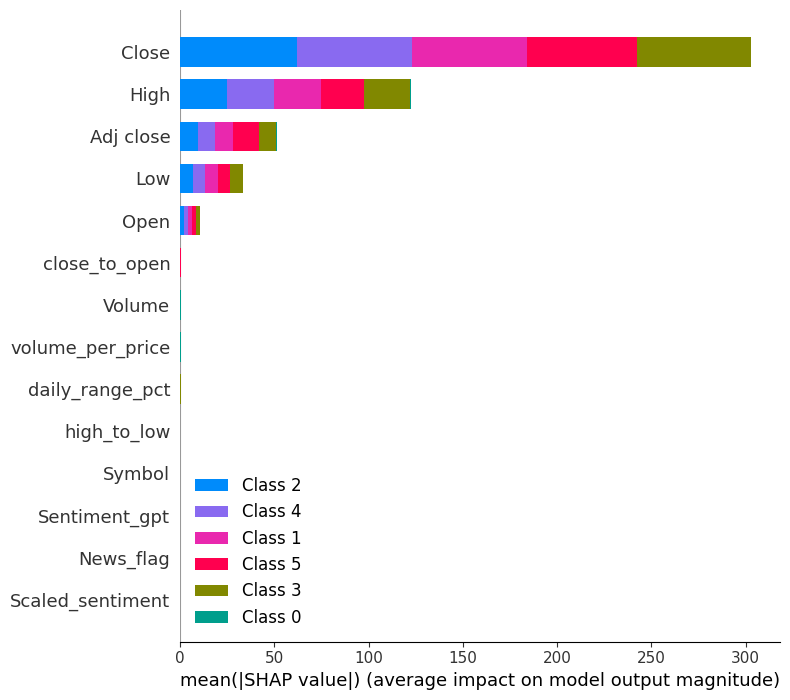

In [ ]:
import shap
import numpy as np
import matplotlib.pyplot as plt

# Sample a subset of data for SHAP (1% of test data)
sample_idx = np.random.choice(X_test.index, size=1000, replace=False)
X_sample = X_test.loc[sample_idx]

# Initialize SHAP TreeExplainer
explainer = shap.TreeExplainer(rf)

# Calculate SHAP values for a smaller sample (100 instances)
shap_values = explainer.shap_values(X_sample.iloc[:100])

# 1. Summary Plot
shap.summary_plot(shap_values, X_sample.iloc[:100], plot_type="bar", max_display=15)

# **LIME**

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

def lime_explainer_multi_output(model, X_train, X_test, feature_names, target_names, num_samples=1000):
    # Convert to numpy arrays
    train_data = X_train.values
    test_samples = X_test.values

    # Create LIME explainer
    explainer = LimeTabularExplainer(
        training_data=train_data,
        feature_names=feature_names,
        mode='regression',
        verbose=True,
        random_state=42
    )

    # 3 different instances
    for instance_idx in [0, 50, 100]:  # Example indices
        print(f"\n=== Explaining instance {instance_idx} ===")
        exp_dict = {}

        # Get sample and prediction
        sample = test_samples[instance_idx]
        prediction = model.predict(sample.reshape(1, -1))[0]

        # Create explanations for each target
        for target_idx, target_name in enumerate(target_names):
            # Wrap model for specific target
            def predict_fn(x):
                return model.predict(x)[:, target_idx]

            # Generate explanation
            exp = explainer.explain_instance(
                sample,
                predict_fn,
                num_features=10,
                num_samples=num_samples
            )

            # Store explanation with prediction value
            exp_dict[target_name] = {
                'explanation': exp,
                'prediction': prediction[target_idx]
            }

        # Display results
        for target_name in target_names:
            print(f"\n--- {target_name} (Predicted: {exp_dict[target_name]['prediction']:.2f}) ---")
            exp_dict[target_name]['explanation'].show_in_notebook(show_table=True)

lime_explainer_multi_output(
    rf,
    X_train,
    X_test,
    feature_names=X.columns.tolist(),
    target_names=target_cols,
    num_samples=5000  # Reduced for faster execution
)


=== Explaining instance 0 ===


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 15.877292991945827
Prediction_local [15.35654324]
Right: 16.347800587435785


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 63.102422254709296
Prediction_local [413.51995593]
Right: 157.76629928588866


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 69.04410400788643
Prediction_local [398.80552946]
Right: 160.03489151000977


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 64.44675248403654
Prediction_local [390.31941763]
Right: 155.66068115234376


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 60.992953315118314
Prediction_local [412.41447974]
Right: 158.2363995361328


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 49.081381127210236
Prediction_local [396.84247472]
Right: 158.1158605957031

--- Volume_tomorrow (Predicted: 16.35) ---



--- Open_tomorrow (Predicted: 157.77) ---



--- High_tomorrow (Predicted: 160.03) ---



--- Low_tomorrow (Predicted: 155.66) ---



--- Close_tomorrow (Predicted: 158.24) ---



--- Adj close_tomorrow (Predicted: 158.12) ---



=== Explaining instance 50 ===


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 15.758404339392856
Prediction_local [15.53661373]
Right: 15.124641594179984


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 169.1111294863393
Prediction_local [93.2701104]
Right: 131.50500976592772


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 173.45563456952146
Prediction_local [94.22173829]
Right: 133.32403167767382


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 162.02521909874145
Prediction_local [96.22067666]
Right: 130.19251480116992


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 171.8294057517266
Prediction_local [89.97749497]
Right: 132.06495597878612


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 148.68999203313723
Prediction_local [94.74986751]
Right: 131.9594713596455

--- Volume_tomorrow (Predicted: 15.12) ---



--- Open_tomorrow (Predicted: 131.51) ---



--- High_tomorrow (Predicted: 133.32) ---



--- Low_tomorrow (Predicted: 130.19) ---



--- Close_tomorrow (Predicted: 132.06) ---



--- Adj close_tomorrow (Predicted: 131.96) ---



=== Explaining instance 100 ===


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 15.568649552207905
Prediction_local [16.24398879]
Right: 16.841875003288784


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 188.92493633930928
Prediction_local [27.31338835]
Right: 33.54650016784668


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 195.8591494573276
Prediction_local [21.79118262]
Right: 33.83569980621338


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 183.98546277955438
Prediction_local [33.21507262]
Right: 33.22475028991699


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 187.11451278918526
Prediction_local [33.00450495]
Right: 33.5372998046875


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Intercept 177.47444369883965
Prediction_local [25.366875]
Right: 28.16602560043335

--- Volume_tomorrow (Predicted: 16.84) ---



--- Open_tomorrow (Predicted: 33.55) ---



--- High_tomorrow (Predicted: 33.84) ---



--- Low_tomorrow (Predicted: 33.22) ---



--- Close_tomorrow (Predicted: 33.54) ---



--- Adj close_tomorrow (Predicted: 28.17) ---


# **sensitivity_analysis**

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


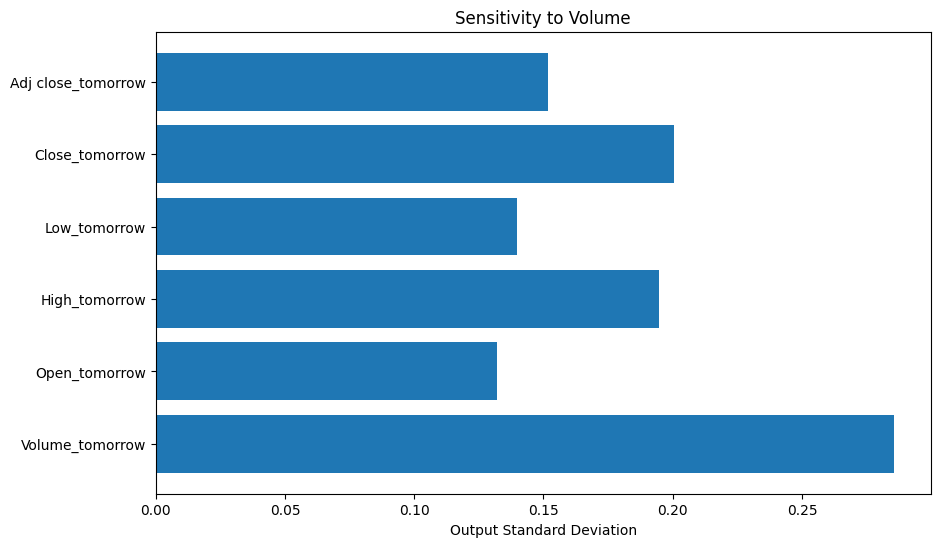

In [30]:
def sensitivity_analysis(model, X, feature, n_samples=1000):
    baseline = X.mean().values.reshape(1, -1)
    samples = np.tile(baseline, (n_samples, 1))
    perturbations = np.random.normal(scale=X[feature].std(), size=n_samples)
    samples[:, X.columns.get_loc(feature)] += perturbations

    preds = model.predict(samples)
    sensitivity = np.std(preds, axis=0)

    plt.figure(figsize=(10,6))
    plt.barh(target_cols, sensitivity)
    plt.title(f"Sensitivity to {feature}")
    plt.xlabel('Output Standard Deviation')
    plt.show()

sensitivity_analysis(rf, X_train, 'Volume')